In [1]:
import uproot as uproot
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import mplhep as hep
import awkward as ak

In [2]:
inputs_root = "/net/scratch_cms3a/hschoenen/deepjet/data/testData/ntuple_merged_342.root:deepntuplizer/tree"

file_ = uproot.open(inputs_root)
columns_ = file_.keys()

In [3]:
columns_

['n_sv',
 'nsv',
 'sv_pt',
 'sv_eta',
 'sv_phi',
 'sv_e',
 'sv_etarel',
 'sv_phirel',
 'sv_deltaR',
 'sv_mass',
 'sv_ntracks',
 'sv_chi2',
 'sv_ndf',
 'sv_normchi2',
 'sv_dxy',
 'sv_dxyerr',
 'sv_dxysig',
 'sv_d3d',
 'sv_d3derr',
 'sv_d3dsig',
 'sv_costhetasvpv',
 'sv_enratio',
 'n_gtracks',
 'nGtracks',
 'gtrack_pt',
 'gtrack_eta',
 'gtrack_phi',
 'gtrack_mass',
 'gtrack_dz',
 'gtrack_dxy',
 'gtrack_3D_ip',
 'gtrack_3D_sip',
 'gtrack_2D_ip',
 'gtrack_2D_sip',
 'gtrack_dR',
 'gtrack_dist_neigh',
 'gtrack_3D_TrackProbability',
 'gtrack_2D_TrackProbability',
 'gtrack_chi2reduced',
 'gtrack_nPixelHits',
 'gtrack_nHits',
 'gtrack_jetAxisDistance',
 'gtrack_jetAxisDlength',
 'gtrack_PCAtrackFromPV',
 'gtrack_dotProdTrack',
 'gtrack_dotProdTrack2D',
 'npv',
 'rho',
 'ntrueInt',
 'event_no',
 'jet_no',
 'gen_pt',
 'Delta_gen_pt',
 'isB',
 'isGBB',
 'isBB',
 'isLeptonicB',
 'isLeptonicB_C',
 'isC',
 'isGCC',
 'isCC',
 'isUD',
 'isS',
 'isG',
 'isPU',
 'isUndefined',
 'genDecay',
 'jet_hflav',


In [4]:
global_branches = ['jet_pt', 'jet_eta','nCpfcand',
                   'nNpfcand','nsv','npv',
                   'TagVarCSV_trackSumJetEtRatio','TagVarCSV_trackSumJetDeltaR','TagVarCSV_vertexCategory',
                   'TagVarCSV_trackSip2dValAboveCharm','TagVarCSV_trackSip2dSigAboveCharm','TagVarCSV_trackSip3dValAboveCharm',
                   'TagVarCSV_trackSip3dSigAboveCharm','TagVarCSV_jetNSelectedTracks','TagVarCSV_jetNTracksEtaRel']
                
cpf_branches = ['Cpfcan_BtagPf_trackEtaRel','Cpfcan_BtagPf_trackPtRel','Cpfcan_BtagPf_trackPPar',
                'Cpfcan_BtagPf_trackDeltaR','Cpfcan_BtagPf_trackPParRatio','Cpfcan_BtagPf_trackSip2dVal',
                'Cpfcan_BtagPf_trackSip2dSig','Cpfcan_BtagPf_trackSip3dVal','Cpfcan_BtagPf_trackSip3dSig',
                'Cpfcan_BtagPf_trackJetDistVal','Cpfcan_ptrel','Cpfcan_drminsv',
                'Cpfcan_VTX_ass','Cpfcan_puppiw','Cpfcan_chi2',
                'Cpfcan_quality']

npf_branches = ['Npfcan_ptrel','Npfcan_deltaR','Npfcan_isGamma',
                'Npfcan_HadFrac', 'Npfcan_drminsv', 'Npfcan_puppiw']
        
vtx_branches = ['sv_pt','sv_deltaR','sv_mass',
                'sv_ntracks','sv_chi2','sv_normchi2',
                'sv_dxy','sv_dxysig','sv_d3d',
                'sv_d3dsig','sv_costhetasvpv','sv_enratio']

y_branches = ['isB','isGBB','isBB','isLeptonicB','isLeptonicB_C','isC','isGCC','isCC','isUD','isS','isG','isPU','isUndefined']

In [5]:
df_glob = file_.arrays(global_branches, library="ak")
df_cpf = file_.arrays(cpf_branches, library="ak")
df_npf = file_.arrays(npf_branches, library="ak")
df_vtx = file_.arrays(vtx_branches, library="ak")

df_y = file_.arrays(y_branches, library="ak")

In [6]:
# get the true jet flavours
isB = ak.to_numpy(df_y['isB'][:])
isGBB = ak.to_numpy(df_y['isGBB'][:])
isBB = ak.to_numpy(df_y['isBB'][:])
isLeptonicB = ak.to_numpy(df_y['isLeptonicB'][:])
isLeptonicB_C = ak.to_numpy(df_y['isLeptonicB_C'][:])
isC = ak.to_numpy(df_y['isC'][:])
isGCC = ak.to_numpy(df_y['isGCC'][:])
isCC = ak.to_numpy(df_y['isCC'][:])
isUD = ak.to_numpy(df_y['isUD'][:])
isS = ak.to_numpy(df_y['isS'][:])
isG = ak.to_numpy(df_y['isG'][:])
isPU = ak.to_numpy(df_y['isPU'][:])
isUndefined = ak.to_numpy(df_y['isUndefined'][:])

B = isB + + isGBB + isBB + isLeptonicB + isLeptonicB_C
C = isC + isGCC + isCC
UDSG = isUD + isS + isG
isDefined = (B+C+UDSG) == 1

In [7]:
df_cpf_clip = ak.pad_none(df_cpf,25,clip=True)
df_npf_clip = ak.pad_none(df_npf,25,clip=True)
df_vtx_clip = ak.pad_none(df_vtx,4,clip=True)

In [8]:
# new version: ignore isPU jets and default values
def quantile_min_max(feature,group='glob',candidate=None):
    if group=='glob':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_glob[feature])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])
    elif group=='cpf':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_cpf_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])
    elif group=='npf':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_npf_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])
    elif group=='vtx':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_vtx_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])
    elif group=='cpf_pts':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_cpf_pts_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np[isDefined & non_default],0.01),np.quantile(array_np[isDefined & non_default],0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])
    elif group=='npf_pts':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_npf_pts_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np[isDefined & non_default],0.01),np.quantile(array_np[isDefined & non_default],0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])
    elif group=='vtx_pts':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_vtx_pts_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        non_default = abs(array_np)>10**(-20)
        mini, maxi = np.quantile(array_np[isDefined & non_default],0.01),np.quantile(array_np[isDefined & non_default],0.99)
        mini_, maxi_ = np.quantile(array_np[isDefined & non_default],0.2),np.quantile(array_np[isDefined & non_default],0.8)
        return [mini, maxi], np.std(array_np[isDefined & non_default & (array_np >= mini_) & (array_np <= maxi_)])

In [9]:
'''
def quantile_min_max(feature,group='glob',candidate=None):
    if group=='glob':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_glob[feature])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
    elif group=='cpf':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_cpf_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
    elif group=='npf':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_npf_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
    elif group=='vtx':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_vtx_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
    elif group=='cpf_pts':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_cpf_pts_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
    elif group=='npf_pts':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_npf_pts_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
    elif group=='vtx_pts':
        print(feature,group,candidate)
        array_np = ak.to_numpy(df_vtx_pts_clip[feature][:,candidate])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)
        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])
'''

"\ndef quantile_min_max(feature,group='glob',candidate=None):\n    if group=='glob':\n        print(feature,group,candidate)\n        array_np = ak.to_numpy(df_glob[feature])\n        array_np = np.where(array_np == -999, 0, array_np)\n        array_np = np.where(array_np ==   -1, 0, array_np)\n        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)\n        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)\n        return [mini, maxi], np.std(array_np[(array_np >= mini_) & (array_np <= maxi_)])\n    elif group=='cpf':\n        print(feature,group,candidate)\n        array_np = ak.to_numpy(df_cpf_clip[feature][:,candidate])\n        array_np = np.where(array_np == -999, 0, array_np)\n        array_np = np.where(array_np ==   -1, 0, array_np)\n        mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)\n        mini_, maxi_ = np.quantile(array_np,0.2),np.quantile(array_np,0.8)\n        return [mini, maxi], np.std(array_np[(array_np >= m

In [10]:
print(quantile_min_max('jet_pt','glob'))

jet_pt glob None
([15.444969825744629, 1535.6858300781278], 74.73113)


In [11]:
global_epsilons = np.zeros(len(global_branches))

global_standardized_epsilons = np.zeros(len(global_branches))

global_ranges = np.zeros((len(global_branches),2))

for (i,key) in enumerate(global_branches):
    range_inputs, standardized_epsilon = quantile_min_max(key,'glob')
    scale_epsilon = (range_inputs[1] - range_inputs[0])/2
    global_epsilons[i] = scale_epsilon
    global_standardized_epsilons[i] = standardized_epsilon
    global_ranges[i] = range_inputs
    print(range_inputs, scale_epsilon, standardized_epsilon)

jet_pt glob None
[15.444969825744629, 1535.6858300781278] 760.1204301261915 74.73113
jet_eta glob None
[-2.3910172843933104, 2.3943071389198303] 2.39266221165657 0.6145052
nCpfcand glob None
[1.0, 36.0] 17.5 2.894827
nNpfcand glob None
[0.0, 20.0] 10.0 2.1313145
nsv glob None
[0.0, 4.0] 2.0 0.42577934
npv glob None
[9.0, 48.0] 19.5 4.1242733
TagVarCSV_trackSumJetEtRatio glob None
[0.0, 0.9856463485956194] 0.4928231742978097 0.10095561
TagVarCSV_trackSumJetDeltaR glob None
[0.0, 2.6554229521751425] 1.3277114760875712 0.0145584075
TagVarCSV_vertexCategory glob None
[0.0, 2.0] 1.0 0.0
TagVarCSV_trackSip2dValAboveCharm glob None
[-0.014902344904839993, 0.036601562052965164] 0.02575195347890258 0.0012583719
TagVarCSV_trackSip2dSigAboveCharm glob None
[-2.80285924911499, 12.758635606765749] 7.780747427940369 0.45256418
TagVarCSV_trackSip3dValAboveCharm glob None
[-0.029931544382125138, 0.06389331802725805] 0.046912431204691594 0.002485084
TagVarCSV_trackSip3dSigAboveCharm glob None
[-5.31543

In [12]:
cpf_epsilons = np.zeros((len(cpf_branches),25))
cpf_standardized_epsilons = np.zeros((len(cpf_branches),25))
cpf_ranges = np.zeros((len(cpf_branches),25, 2))
for (i,key) in enumerate(cpf_branches):
    for cand in range(25):
        range_inputs, standardized_epsilon = quantile_min_max(key,'cpf',cand)
        scale_epsilon = (range_inputs[1] - range_inputs[0])/2
        cpf_epsilons[i,cand] = scale_epsilon
        cpf_standardized_epsilons[i,cand] = standardized_epsilon
        cpf_ranges[i,cand] = range_inputs
        print(range_inputs, scale_epsilon, standardized_epsilon)

Cpfcan_BtagPf_trackEtaRel cpf 0
[1.617732959985733, 6.018733162879944] 2.2005001014471057 0.44559535
Cpfcan_BtagPf_trackEtaRel cpf 1
[0.0, 6.157034592628479] 3.0785172963142395 0.47140878
Cpfcan_BtagPf_trackEtaRel cpf 2
[0.0, 6.215461888313295] 3.1077309441566476 0.4874206
Cpfcan_BtagPf_trackEtaRel cpf 3
[0.0, 6.238176612854007] 3.1190883064270034 0.49579585
Cpfcan_BtagPf_trackEtaRel cpf 4
[0.0, 6.228526821136475] 3.1142634105682374 0.5067704
Cpfcan_BtagPf_trackEtaRel cpf 5
[0.0, 6.210646243095399] 3.1053231215476993 0.52041
Cpfcan_BtagPf_trackEtaRel cpf 6
[0.0, 6.171495952606201] 3.0857479763031006 0.52893186
Cpfcan_BtagPf_trackEtaRel cpf 7
[0.0, 6.107757148742677] 3.0538785743713386 0.5359782
Cpfcan_BtagPf_trackEtaRel cpf 8
[0.0, 6.021005077362061] 3.0105025386810307 0.5391905
Cpfcan_BtagPf_trackEtaRel cpf 9
[0.0, 5.941444015502931] 2.9707220077514656 0.5444596
Cpfcan_BtagPf_trackEtaRel cpf 10
[0.0, 5.858443384170533] 2.9292216920852665 0.54455084
Cpfcan_BtagPf_trackEtaRel cpf 11
[0.

In [13]:
npf_epsilons = np.zeros((len(npf_branches),25))
npf_standardized_epsilons = np.zeros((len(npf_branches),25))
npf_ranges = np.zeros((len(npf_branches),25, 2))
for (i,key) in enumerate(npf_branches):
    for cand in range(25):
        range_inputs, standardized_epsilon = quantile_min_max(key,'npf',cand)
        scale_epsilon = (range_inputs[1] - range_inputs[0])/2
        npf_epsilons[i,cand] = scale_epsilon
        npf_standardized_epsilons[i,cand] = standardized_epsilon
        npf_ranges[i,cand] = range_inputs
        print(range_inputs, scale_epsilon, standardized_epsilon)

Npfcan_ptrel npf 0
[-0.996482680439949, 9.06605809638243e-39] 0.4982413402199745 0.0612454
Npfcan_ptrel npf 1
[-0.9978387385606766, 1.0310479095678384e-38] 0.4989193692803383 0.02527257
Npfcan_ptrel npf 2
[-0.9984986788034439, 1.908204927510848e-39] 0.49924933940172195 0.015761752
Npfcan_ptrel npf 3
[-0.9986718302965164, 2.3901500891778286e-39] 0.4993359151482582 0.011793676
Npfcan_ptrel npf 4
[-0.9987648129463196, 2.9946303236943065e-39] 0.4993824064731598 0.008973681
Npfcan_ptrel npf 5
[-0.9988052845001221, 2.9892240441540184e-39] 0.49940264225006104 0.006997285
Npfcan_ptrel npf 6
[-0.9988275766372681, 2.974158474169292e-39] 0.49941378831863403 0.0056884363
Npfcan_ptrel npf 7
[-0.9988074308633804, 2.727291289306665e-40] 0.4994037154316902 0.0046824715
Npfcan_ptrel npf 8
[-0.9987912184000015, 2.732097743039299e-40] 0.49939560920000076 0.0039090095
Npfcan_ptrel npf 9
[-0.9987550383806229, 2.735643028154041e-40] 0.4993775191903114 0.0033334338
Npfcan_ptrel npf 10
[-0.9986810094118118, 2

In [14]:
vtx_epsilons = np.zeros((len(vtx_branches),4))
vtx_standardized_epsilons = np.zeros((len(vtx_branches),4))
vtx_ranges = np.zeros((len(vtx_branches),4, 2))
for (i,key) in enumerate(vtx_branches):
    for cand in range(4):
        range_inputs, standardized_epsilon = quantile_min_max(key,'vtx',cand)
        scale_epsilon = (range_inputs[1] - range_inputs[0])/2
        vtx_epsilons[i,cand] = scale_epsilon
        vtx_standardized_epsilons[i,cand] = standardized_epsilon
        vtx_ranges[i,cand] = range_inputs
        print(range_inputs, scale_epsilon, standardized_epsilon)

sv_pt vtx 0
[0.0, 269.856730957032] 134.928365478516 12.37748
sv_pt vtx 1
[0.0, 171.2651483154304] 85.6325741577152 18.701628
sv_pt vtx 2
[0.0, 91.20212493896494] 45.60106246948247 24.152096
sv_pt vtx 3
[0.0, 25.960402469635014] 12.980201234817507 27.03949
sv_deltaR vtx 0
[-0.4964105808734894, 3.5949752984165918e-40] 0.2482052904367447 0.032313347
sv_deltaR vtx 1
[-0.49311417460441587, 2.7374647161576632e-40] 0.24655708730220793 0.035471193
sv_deltaR vtx 2
[-0.48370381295681, 2.743770559247125e-40] 0.241851906478405 0.036630787
sv_deltaR vtx 3
[-0.43024378061294555, 2.74564829918932e-40] 0.21512189030647277 0.035758372
sv_mass vtx 0
[0.0, 9.330854740142827] 4.665427370071414 0.5050237
sv_mass vtx 1
[0.0, 7.012408280372625] 3.5062041401863127 0.67170465
sv_mass vtx 2
[0.0, 3.7697309327125565] 1.8848654663562783 0.9192604
sv_mass vtx 3
[0.0, 1.131785563230515] 0.5658927816152575 1.1235031
sv_ntracks vtx 0
[0.0, 8.0] 4.0 0.73454106
sv_ntracks vtx 1
[0.0, 7.0] 3.5 0.7210517
sv_ntracks vtx 

In [15]:
np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/global_epsilons.npy',global_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/global_standardized_epsilons.npy',global_standardized_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/global_ranges.npy',global_ranges)
np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/cpf_epsilons.npy',cpf_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/cpf_standardized_epsilons.npy',cpf_standardized_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/cpf_ranges.npy',cpf_ranges)
np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/npf_epsilons.npy',npf_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/npf_standardized_epsilons.npy',npf_standardized_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/npf_ranges.npy',npf_ranges)
np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/vtx_epsilons.npy',vtx_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/vtx_standardized_epsilons.npy',vtx_standardized_epsilons)
#np.save('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/vtx_ranges.npy',vtx_ranges)

jet_pt: minimum 12.345 , maximum 1903.410
    -999: 0 , -1: 0 , 0:0
jet_eta: minimum -2.500 , maximum 2.500
    -999: 0 , -1: 0 , 0:0
nCpfcand: minimum 0.000 , maximum 50.000
    -999: 0 , -1: 0 , 0:2655
nNpfcand: minimum 0.000 , maximum 41.000
    -999: 0 , -1: 0 , 0:12956
nsv: minimum 0.000 , maximum 10.000
    -999: 0 , -1: 0 , 0:218620
npv: minimum 1.000 , maximum 98.000
    -999: 0 , -1: 0 , 0:0
TagVarCSV_trackSumJetEtRatio: minimum 0.000 , maximum 19.190
    -999: 0 , -1: 0 , 0:19059
TagVarCSV_trackSumJetDeltaR: minimum 0.000 , maximum 4.004
    -999: 0 , -1: 0 , 0:6128
TagVarCSV_vertexCategory: minimum 0.000 , maximum 2.000
    -999: 0 , -1: 0 , 0:128473
TagVarCSV_trackSip2dValAboveCharm: minimum -0.198 , maximum 0.197
    -999: 0 , -1: 0 , 0:84336
TagVarCSV_trackSip2dSigAboveCharm: minimum -64.763 , maximum 104.583
    -999: 0 , -1: 0 , 0:84336
TagVarCSV_trackSip3dValAboveCharm: minimum -1.755 , maximum 0.957
    -999: 0 , -1: 0 , 0:84336
TagVarCSV_trackSip3dSigAboveCharm: mini

<ipython-input-20-1a1cf7546392>:102: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax = plt.subplots(figsize=[12,12], dpi=300)


Cpfcan_BtagPf_trackSip2dSig: minimum -0.999 , maximum 10717.586
    -999: 0 , -1: 0 , 0:3380
Cpfcan_BtagPf_trackSip3dVal: minimum -1.000 , maximum 102.770
    -999: 0 , -1: 0 , 0:17907
Cpfcan_BtagPf_trackSip3dSig: minimum -1.000 , maximum 35603.805
    -999: 0 , -1: 0 , 0:46402
Cpfcan_BtagPf_trackJetDistVal: minimum -20.000 , maximum 4.601
    -999: 0 , -1: 0 , 0:35
Cpfcan_ptrel: minimum -0.999 , maximum 4.601
    -999: 0 , -1: 0 , 0:20
Cpfcan_drminsv: minimum -0.400 , maximum 4.601
    -999: 0 , -1: 0 , 0:221003
Cpfcan_VTX_ass: minimum 0.000 , maximum 7.000
    -999: 0 , -1: 0 , 0:1503
Cpfcan_puppiw: minimum 0.000 , maximum 4.601
    -999: 0 , -1: 0 , 0:181484
Cpfcan_chi2: minimum 0.000 , maximum 248.000
    -999: 0 , -1: 0 , 0:206504
Cpfcan_quality: minimum 0.000 , maximum 5.000
    -999: 0 , -1: 0 , 0:12
Npfcan_ptrel: minimum -0.999 , maximum 5.000
    -999: 0 , -1: 0 , 0:0
Npfcan_deltaR: minimum -0.600 , maximum 5.000
    -999: 0 , -1: 0 , 0:0
Npfcan_isGamma: minimum 0.000 , maximu

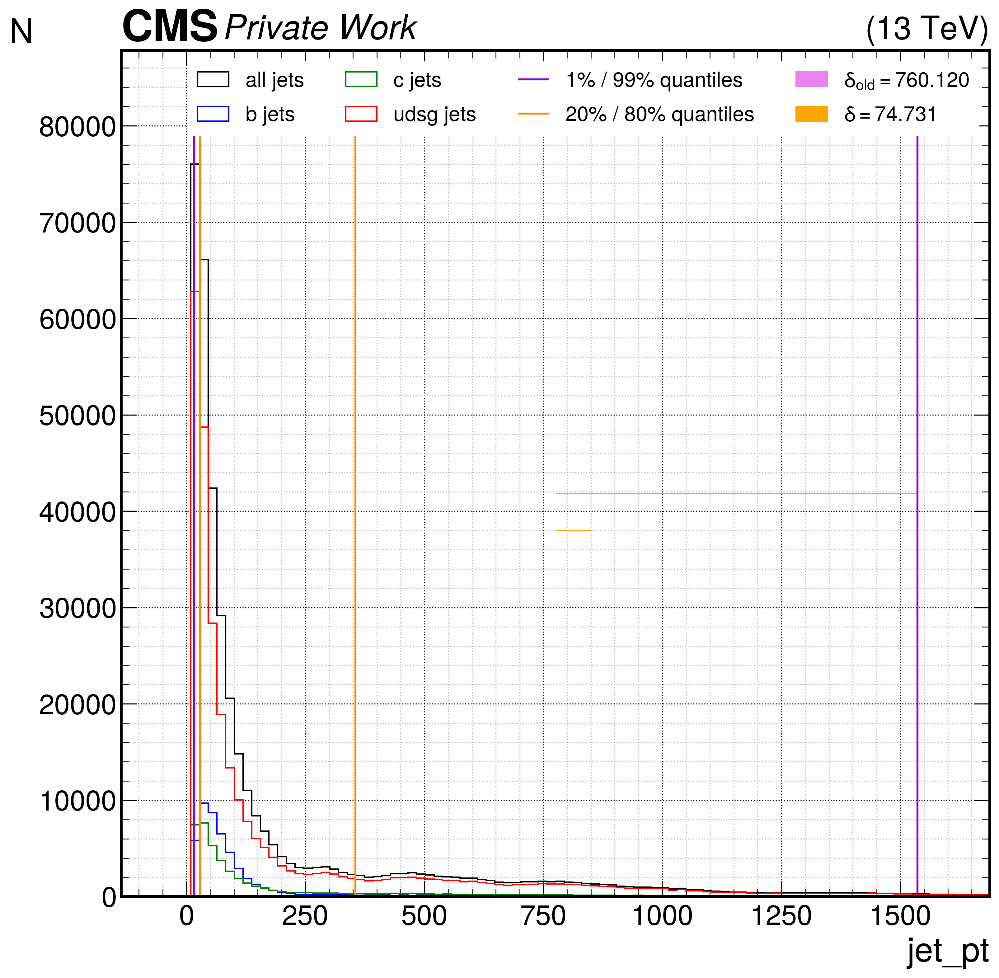

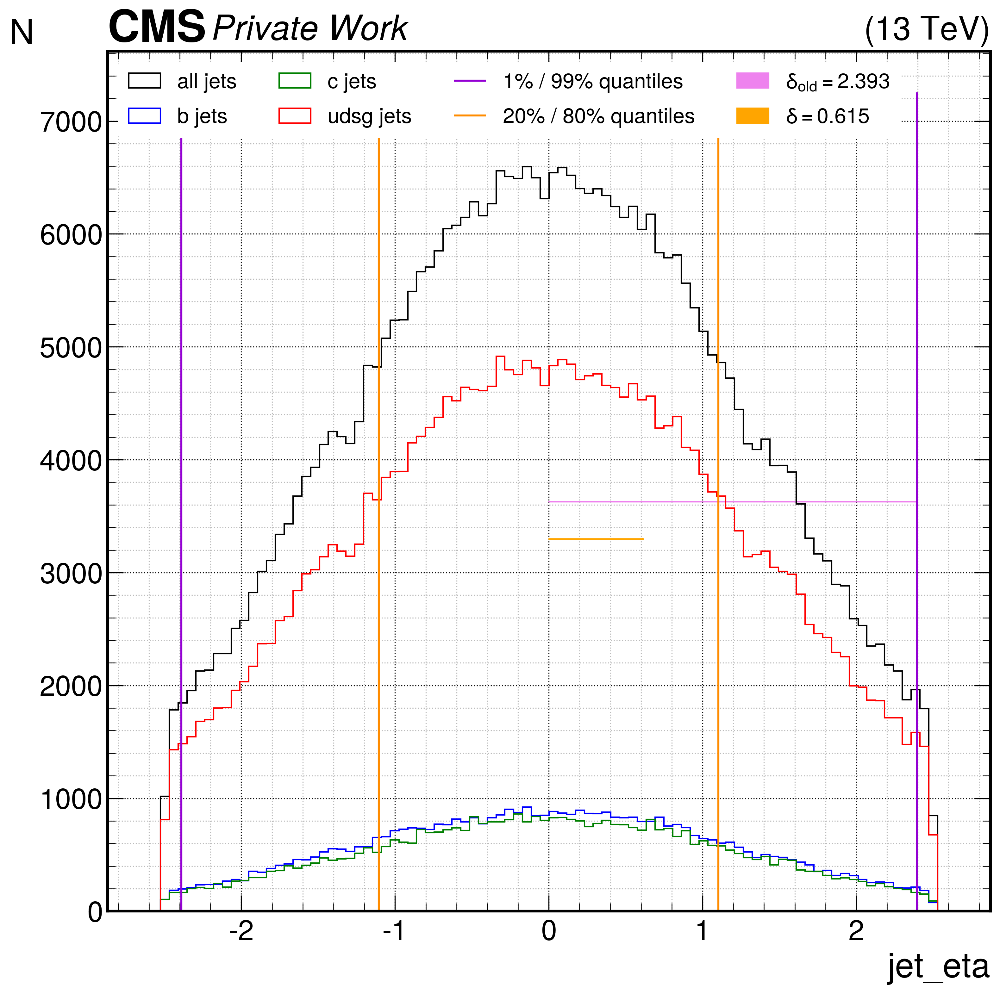

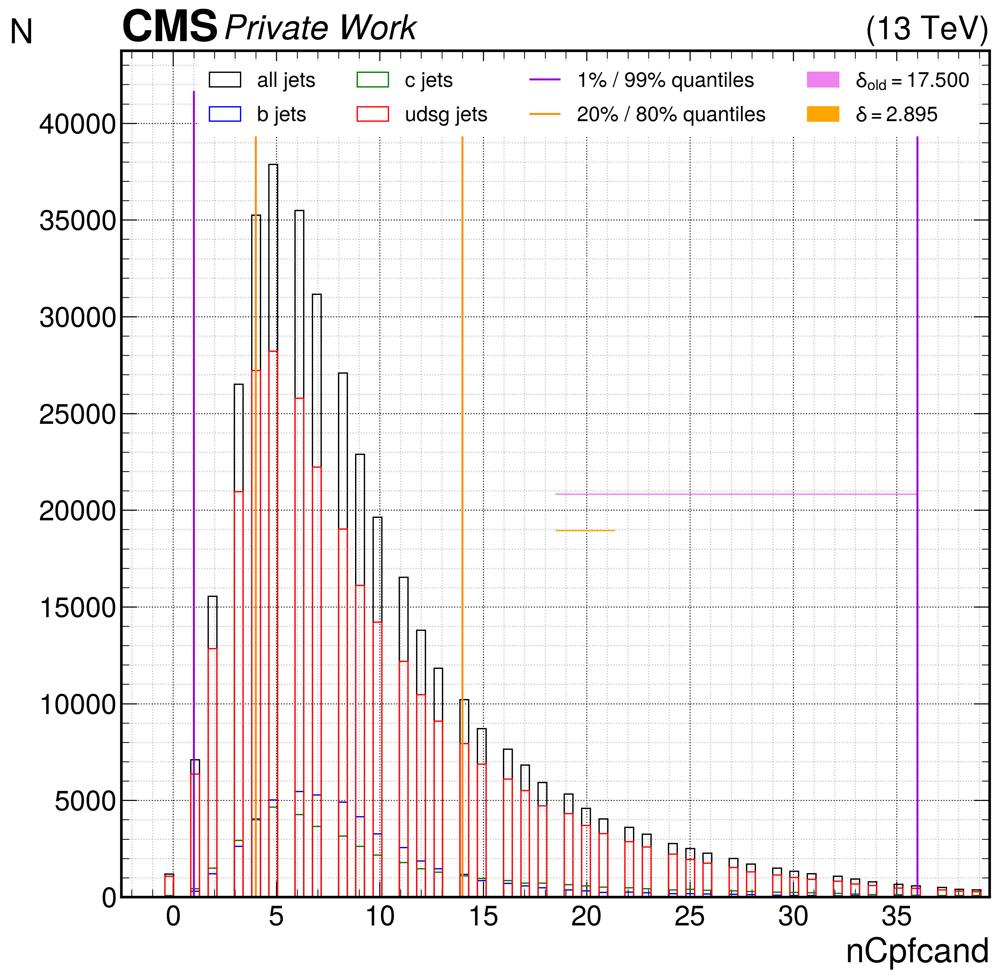

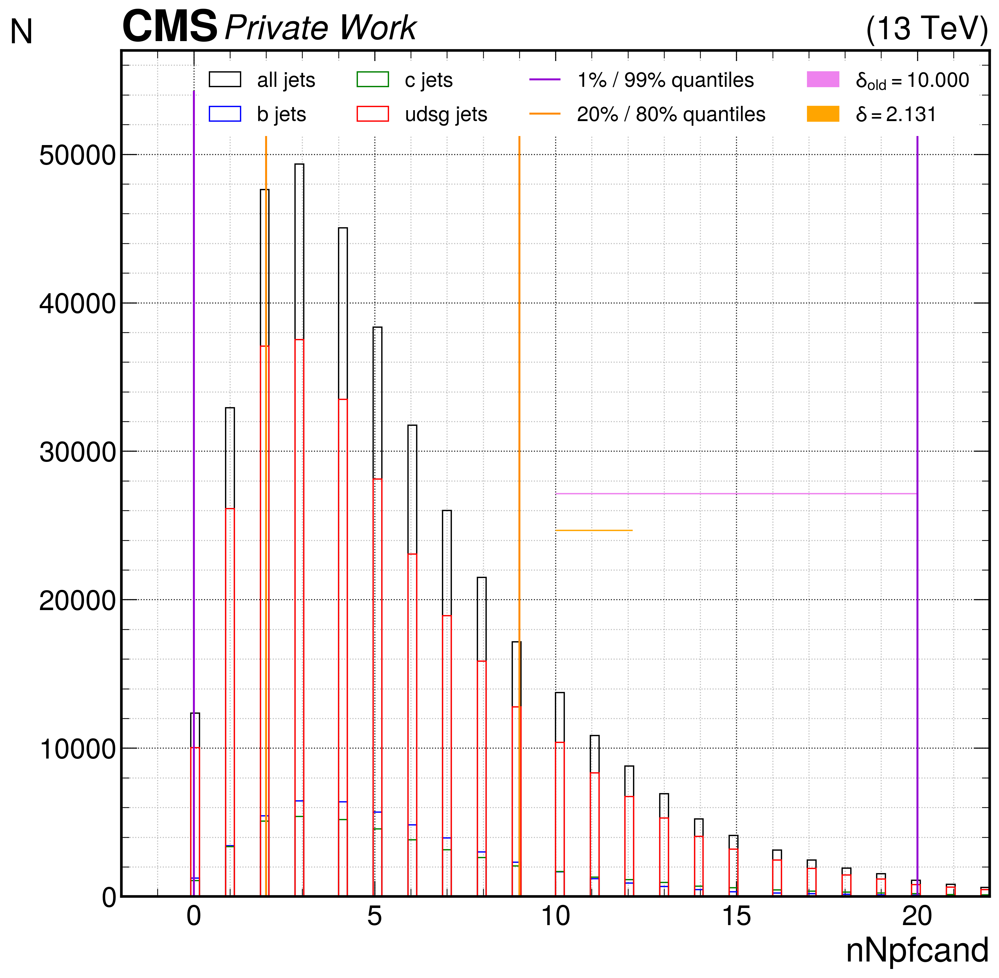

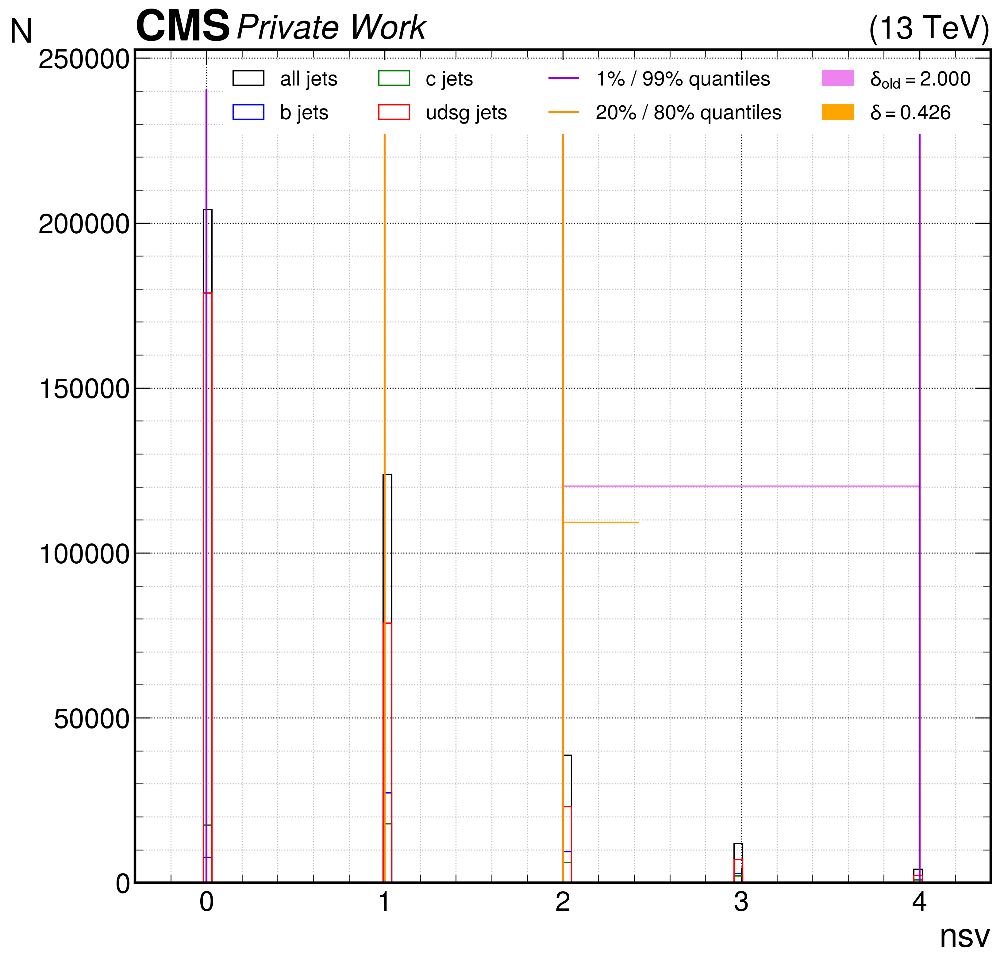

...

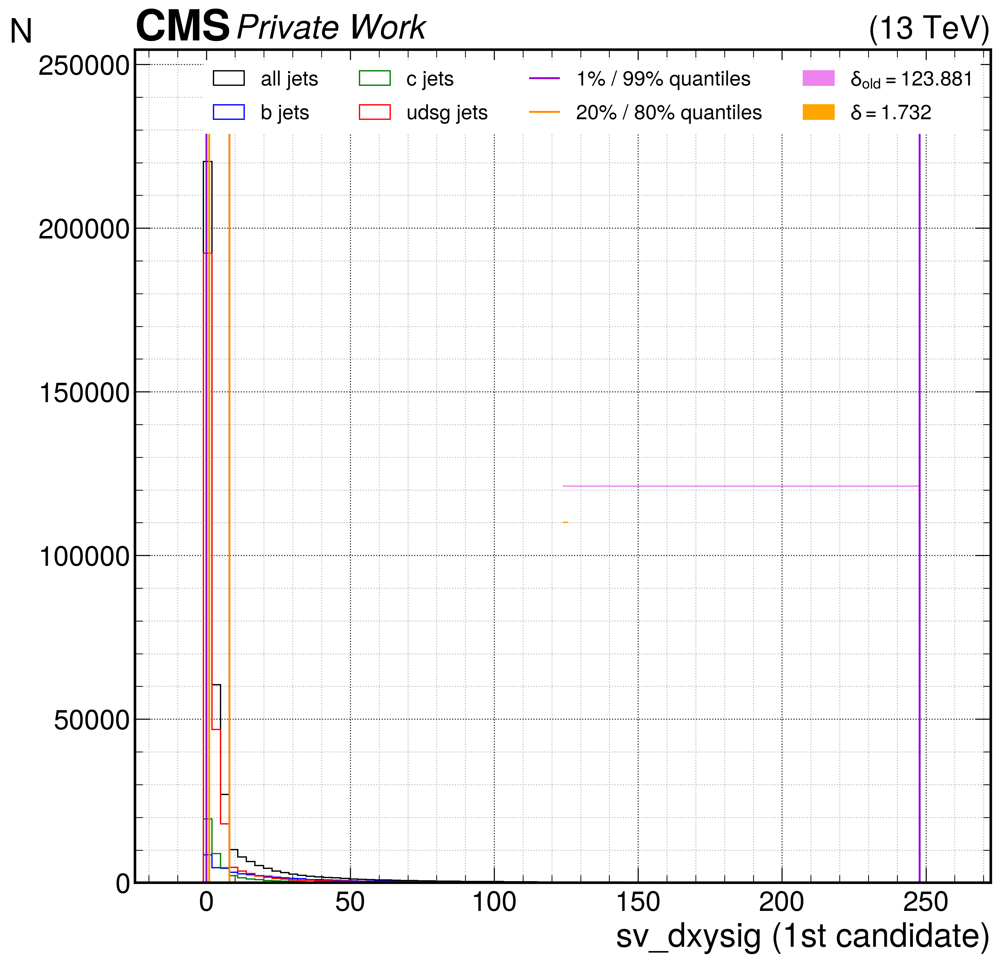

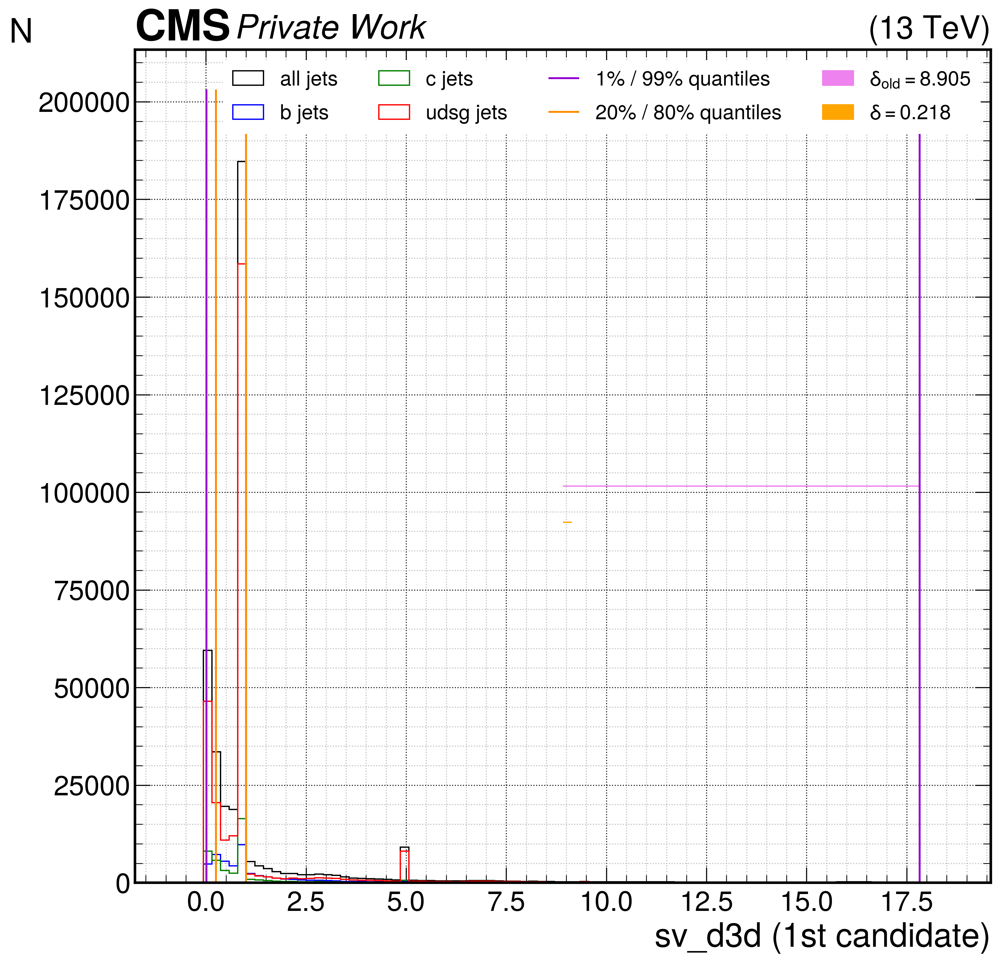

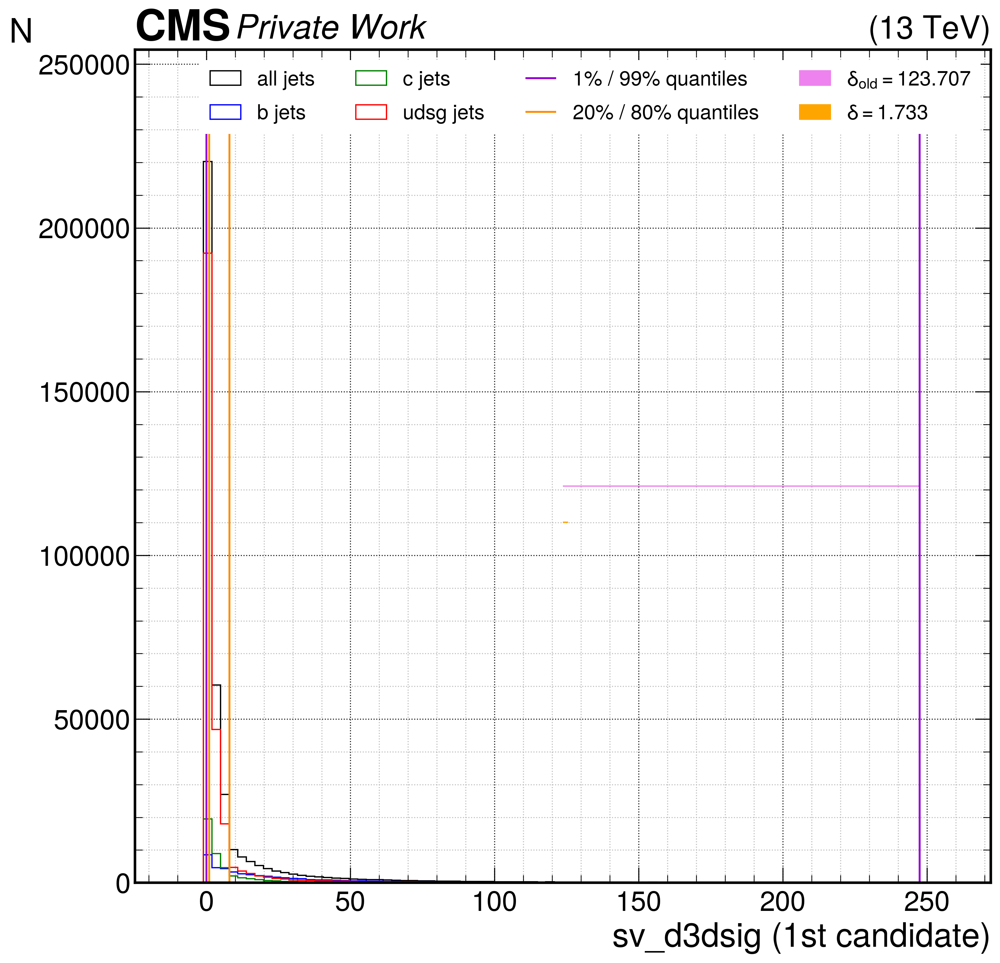

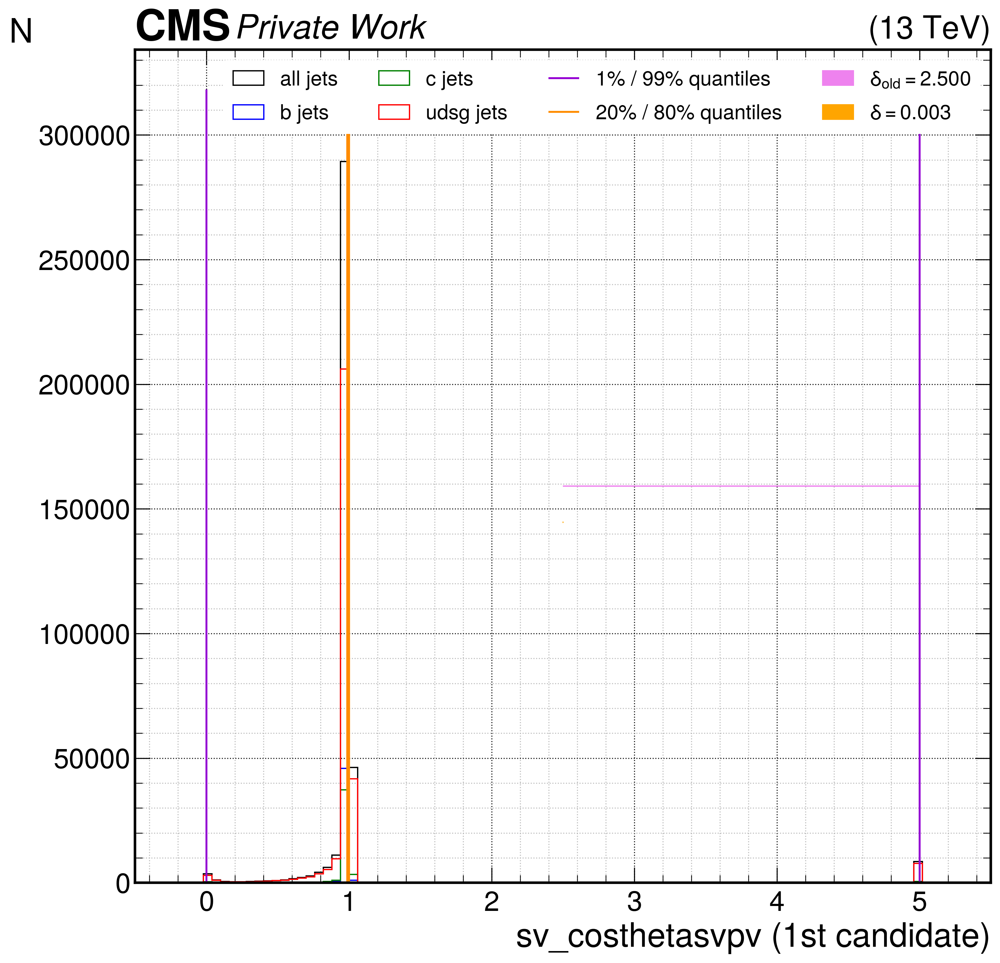

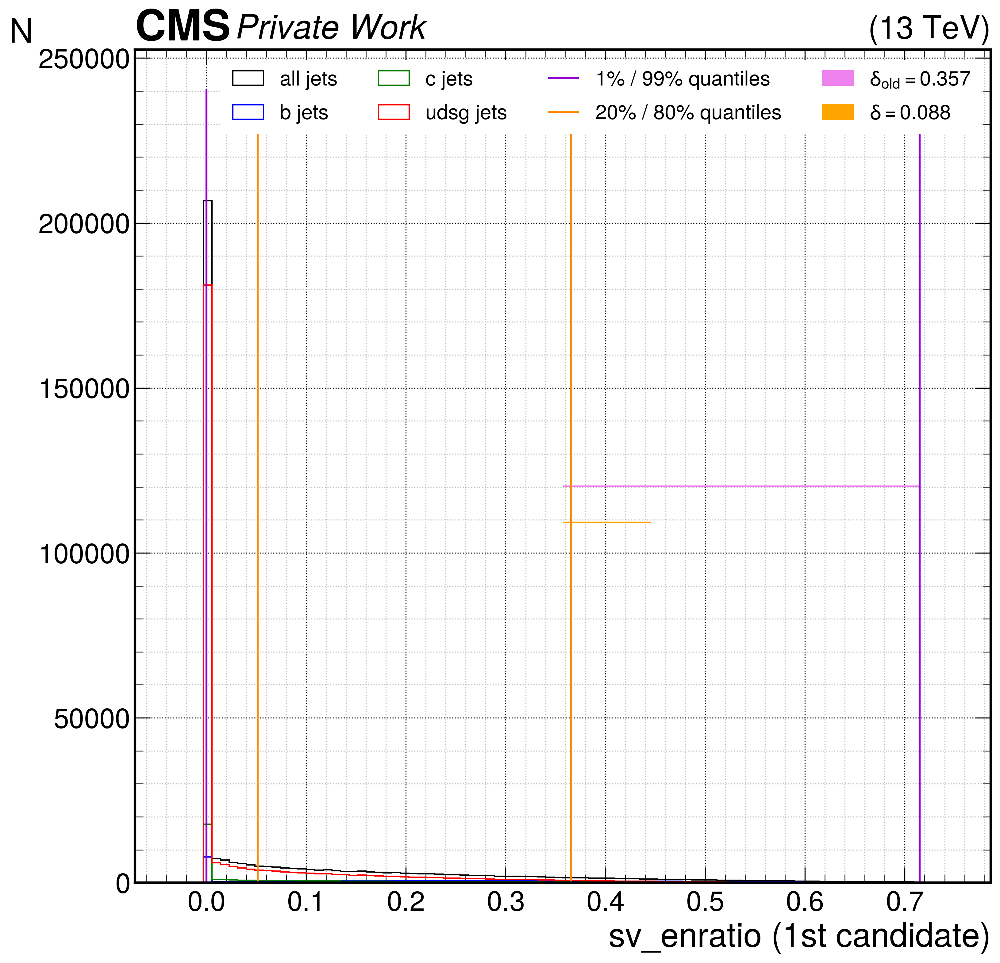

In [20]:
### Comparison of old and new epsilons

# get saved epsilons from file
file_global_standardized_epsilons = np.load('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/global_standardized_epsilons.npy')
file_cpf_standardized_epsilons = np.load('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/cpf_standardized_epsilons.npy')
file_npf_standardized_epsilons = np.load('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/npf_standardized_epsilons.npy')
file_vtx_standardized_epsilons = np.load('/home/home1/institut_3a/hschoenen/repositories/DeepJet/epsilons/vtx_standardized_epsilons.npy')

# get true flavours
isB = ak.to_numpy(df_y['isB'][:])
isGBB = ak.to_numpy(df_y['isGBB'][:])
isBB = ak.to_numpy(df_y['isBB'][:])
isLeptonicB = ak.to_numpy(df_y['isLeptonicB'][:])
isLeptonicB_C = ak.to_numpy(df_y['isLeptonicB_C'][:])
isC = ak.to_numpy(df_y['isC'][:])
isGCC = ak.to_numpy(df_y['isGCC'][:])
isCC = ak.to_numpy(df_y['isCC'][:])
isUD = ak.to_numpy(df_y['isUD'][:])
isS = ak.to_numpy(df_y['isS'][:])
isG = ak.to_numpy(df_y['isG'][:])
isPU = ak.to_numpy(df_y['isPU'][:])
isUndefined = ak.to_numpy(df_y['isUndefined'][:])

B = isB + + isGBB + isBB + isLeptonicB + isLeptonicB_C
C = isC + isGCC + isCC
UDSG = isUD + isS + isG
isDefined = (B+C+UDSG) == 1

#keys = ['jet_pt','jet_eta','Cpfcan_BtagPf_trackDeltaR',
        #'Cpfcan_BtagPf_trackPParRatio','Cpfcan_BtagPf_trackSip2dVal','Cpfcan_BtagPf_trackSip2dSig','Cpfcan_BtagPf_trackSip3dVal','Cpfcan_BtagPf_trackSip3dSig',
        #'Npfcan_ptrel','Npfcan_deltaR',
        #'sv_deltaR','sv_mass','sv_dxy','sv_dxysig','sv_d3d','sv_d3dsig']

keys = ['jet_pt', 'jet_eta', 'nCpfcand','nNpfcand', 'nsv','npv', 'TagVarCSV_trackSumJetEtRatio', 'TagVarCSV_trackSumJetDeltaR', 'TagVarCSV_vertexCategory', 'TagVarCSV_trackSip2dValAboveCharm', 'TagVarCSV_trackSip2dSigAboveCharm', 'TagVarCSV_trackSip3dValAboveCharm', 'TagVarCSV_trackSip3dSigAboveCharm', 'TagVarCSV_jetNSelectedTracks', 'TagVarCSV_jetNTracksEtaRel',
        'Cpfcan_BtagPf_trackEtaRel', 'Cpfcan_BtagPf_trackPtRel', 'Cpfcan_BtagPf_trackPPar', 'Cpfcan_BtagPf_trackDeltaR', 'Cpfcan_BtagPf_trackPParRatio', 'Cpfcan_BtagPf_trackSip2dVal', 'Cpfcan_BtagPf_trackSip2dSig', 'Cpfcan_BtagPf_trackSip3dVal', 'Cpfcan_BtagPf_trackSip3dSig', 'Cpfcan_BtagPf_trackJetDistVal', 'Cpfcan_ptrel', 'Cpfcan_drminsv', 'Cpfcan_VTX_ass', 'Cpfcan_puppiw', 'Cpfcan_chi2', 'Cpfcan_quality',
        'Npfcan_ptrel', 'Npfcan_deltaR', 'Npfcan_isGamma', 'Npfcan_HadFrac', 'Npfcan_drminsv', 'Npfcan_puppiw',
        'sv_pt','sv_deltaR', 'sv_mass', 'sv_ntracks', 'sv_chi2', 'sv_normchi2', 'sv_dxy', 'sv_dxysig', 'sv_d3d', 'sv_d3dsig', 'sv_costhetasvpv', 'sv_enratio']

saveDir = '/home/home1/institut_3a/hschoenen/plots'

for key in keys:
    # get array of variable
    if key in global_branches:
        i = np.where(np.array(global_branches)==key)[0]
        array_np = ak.to_numpy(df_glob[key][:])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
    elif key in cpf_branches:
        i = np.where(np.array(cpf_branches)==key)[0]
        array_np = ak.to_numpy(df_cpf_clip[key][:,0])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
    elif key in npf_branches:
        i = np.where(np.array(npf_branches)==key)[0]
        array_np = ak.to_numpy(df_npf_clip[key][:,0])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
    elif key in vtx_branches:
        i = np.where(np.array(vtx_branches)==key)[0]
        array_np = ak.to_numpy(df_vtx_clip[key][:,0])
        array_np = np.where(array_np == -999, 0, array_np)
        array_np = np.where(array_np ==   -1, 0, array_np)
    else:
        print('key error: ',key)

    # exclude default values
    non_default = abs(array_np)>10**(-20)
    # compute epsilons 
    mini, maxi = np.quantile(array_np,0.01),np.quantile(array_np,0.99)
    mini_, maxi_ = np.quantile(array_np[non_default & isDefined],0.2),np.quantile(array_np[non_default & isDefined],0.8)
    epsilon = (maxi - mini) / 2
    standardized_epsilon = np.std(array_np[(array_np >= mini_) & (array_np <= maxi_) & non_default & isDefined])
    mean = np.mean(array_np[(array_np >= mini_) & (array_np <= maxi_) & non_default & isDefined])
    middle = (maxi+mini)/2

    # print some information about the epsilons
    print('{}: minimum {:.3f} , maximum {:.3f}'.format(key,np.min(array_np),np.max(array_np)))
    print('    -999: {:n} , -1: {:n} , 0:{:n}'.format(len(np.where(array_np==-999)[0]),len(np.where(array_np==-1)[0]),len(np.where(array_np==0)[0])))
    #print('mini = {:.3f} , maxi = {:.3f} , mini_ = {:.3f} , maxi_ = {:.3f}'.format(mini,maxi,mini_,maxi_))
    #print('epsilon = {:.5f} , standardized epsilons = {:.5f}'.format(epsilon,standardized_epsilon))
    if key in global_branches:
        i = np.where(np.array(global_branches)==key)[0][0]
        #print('calculation from above: standardized epsilons = {:.5f}'.format(global_standardized_epsilons[i]))
        #print('entry from file: standardized epsilons = {:.5f}'.format(file_global_standardized_epsilons[i]))
    elif key in cpf_branches:
        i = np.where(np.array(cpf_branches)==key)[0][0]
        #print('calculation from above: standardized epsilons = {:.5f}'.format(cpf_standardized_epsilons[i,0]))
        #print('entry from file: standardized epsilons = {:.5f}'.format(file_cpf_standardized_epsilons[i,0]))
    elif key in npf_branches:
        i = np.where(np.array(npf_branches)==key)[0][0]
        #print('calculation from above: standardized epsilons = {:.5f}'.format(npf_standardized_epsilons[i,0]))
        #print('entry from file: standardized epsilons = {:.5f}'.format(file_npf_standardized_epsilons[i,0]))
    elif key in vtx_branches:
        i = np.where(np.array(vtx_branches)==key)[0][0]
        #print('calculation from above: standardized epsilons = {:.5f}'.format(vtx_standardized_epsilons[i,0]))
        #print('entry from file: standardized epsilons = {:.5f}'.format(file_vtx_standardized_epsilons[i,0]))

    binning = [mini-0.1*abs(maxi-mini), maxi+0.1*abs(maxi-mini), 100]
    plt.style.use(hep.cms.style.ROOT)
    plt.rcParams['axes.axisbelow'] = True
    # make figure
    fig,ax = plt.subplots(figsize=[12,12], dpi=300)
    ax.set_xlim(left=binning[0], right=binning[1])
    ax.set_ylabel('N',rotation='horizontal')
    if key in global_branches:
        ax.set_xlabel(key)
    else:
        ax.set_xlabel(key+' (1st candidate)')
    ax.grid(which='minor', alpha=0.85)
    ax.grid(which='major', alpha=0.95, color='black')
    # plot histogram
    entries, bins, patches = ax.hist(array_np[B+C+UDSG==1], bins=binning[2], range=(binning[0],binning[1]), label='all jets', color='black', histtype='step')
    ymax = np.max([np.max(entries),np.sum(non_default==0)])
    ax.hist(array_np[B==1], bins=binning[2], range=(binning[0],binning[1]), label='b jets', color='blue', histtype='step')
    ax.hist(array_np[C==1], bins=binning[2], range=(binning[0],binning[1]), label='c jets', color='green', histtype='step')
    ax.hist(array_np[UDSG==1], bins=binning[2], range=(binning[0],binning[1]), label='udsg jets', color='red', histtype='step')
    # plot quantiles
    ax.vlines([mini,maxi], 0, 1.1*ymax, colors='darkviolet', label='1% / 99% quantiles')
    ax.vlines([mini_,maxi_], 0, 1.1*ymax, colors='darkorange', label='20% / 80% quantiles')
    # plot epsilons
    ax.arrow(x=middle, y=0.55*ymax, dx=epsilon, dy=0, color='violet', label='$\delta_{old}=$'+'{:.3f}'.format(epsilon), length_includes_head=True)
    ax.arrow(x=middle, y=0.5*ymax, dx=standardized_epsilon, dy=0, color='orange', label='$\delta=$'+'{:.3f}'.format(standardized_epsilon), length_includes_head=True)
    if np.mean(array_np)>middle:
        legloc = 'upper left'
    else:
        legloc = 'upper right'
    leg=ax.legend(fontsize=16, ncol=4, labelspacing=0.7, loc=legloc, frameon=True, framealpha=1, facecolor='white')
    if 'right' in legloc:
        aligned = 'right'
    else:
        aligned = 'left'
    leg._legend_box.align = aligned
    leg.get_frame().set_linewidth(0.0)
    hep.cms.label(llabel='Private Work', rlabel='(13 TeV)')
    fig.savefig('{}/deltas/delta-{}.pdf'.format(saveDir,key))
    

In [17]:
keys = vtx_branches
for key in keys:
    print((key+' &  &  &  &  \\\\').replace('_','\_'))
    print('\hline &&&&\\\\[-1em]')

sv\_pt &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_deltaR &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_mass &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_ntracks &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_chi2 &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_normchi2 &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_dxy &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_dxysig &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_d3d &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_d3dsig &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_costhetasvpv &  &  &  &  \\
\hline &&&&\\[-1em]
sv\_enratio &  &  &  &  \\
\hline &&&&\\[-1em]


In [18]:
flavours = [isB,isGBB,isBB,isLeptonicB,isLeptonicB_C,isC,isGCC,isCC,isUD,isS,isG,isPU,isUndefined]
flavour_names = ['isB','isGBB','isBB','isLeptonicB','isLeptonicB_C','isC','isGCC','isCC','isUD','isS','isG','isPU','isUndefined']
sum = 0
for i in range(len(flavours)):
    print('{}: {:n}'.format(flavour_names[i], np.sum(flavours[i])))
    sum += np.sum(flavours[i])
print('total: {:n} \n'.format(sum))


flavours = [isB,isGBB+isBB,isLeptonicB+isLeptonicB_C,isC+isGCC+isCC,isUD+isS,isG]
flavour_names = ['isB','isBB','isLeptonicB','isC','isUDS','isG']
sum = 0
for i in range(len(flavours)):
    print('{}: {:n}'.format(flavour_names[i], np.sum(flavours[i])))
    sum += np.sum(flavours[i])
print('total: {:n}'.format(sum))

isB: 28340
isGBB: 1989
isBB: 1852
isLeptonicB: 9219
isLeptonicB_C: 7609
isC: 33499
isGCC: 5403
isCC: 5962
isUD: 111542
isS: 25536
isG: 153888
isPU: 15161
isUndefined: 0
total: 400000 

isB: 28340
isBB: 3841
isLeptonicB: 16828
isC: 44864
isUDS: 137078
isG: 153888
total: 384839
